In [1]:
import numpy as np
import matplotlib.pyplot as plt
import time
import math

In [2]:
plt.rcParams.update({'font.size': 15})

In [3]:
run /home/lmberkhout/src/pychfpga/pychfpga/sifpga_crs_corr_capture.py --serial 0026 --prog 2

Enabling nested event loop on current loop ID 134140176193808
Opened TCPipe socket at ('10.10.10.33', 43784)


There are no IceCrates in the hardware map!


+--------------+-----------------+
| Standalone   | Virt. slot None |
| Motherboards | CRS_SN0026      |
|              | 10.10.10.203    |
+--------------+-----------------+
| Mezz1        | -               |
| Mezz2        | -               |
+--------------+-----------------+

Forcing output 0 mode to LVPECL because fout is high
Forcing output 8 mode to LVPECL because fout is high
Forcing output 9 mode to LVPECL because fout is high
Forcing output 10 mode to LVPECL because fout is high
Forcing output 11 mode to LVPECL because fout is high
Forcing output 12 mode to LVPECL because fout is high
TCPipe: Programming FPGA with 34437356 bytes


chFPGA(None, 'CRS_SN0026'): Sync is not yet implemented on the CRS
chFPGA(None, 'CRS_SN0026'): Sync is not yet implemented on the CRS
chFPGA(None, 'CRS_SN0026'): There is no 1st CROSSBAR module in this firmware build (so there can't be data streamed to the correlators or GPU links!)
chFPGA(None, 'CRS_SN0026'): There is no 2nd CROSSBAR module in this firmware build
chFPGA(None, 'CRS_SN0026'): There is no 3rd CROSSBAR module in this firmware build
{self!r}: Cannot set data width on UCorn. Width is hardware fixed at 4+4i bits.Command is ignored. 
{self!r}: set_frames_per_packet is not implemented on UCorn. Packet size is set through the playlist. Command is ignored. 
The platform does not support SYNC sources
chFPGA(None, 'CRS_SN0026'): Sync is not yet implemented on the CRS
chFPGA(None, 'CRS_SN0026'): Sync is not yet implemented on the CRS
FPGAArray(1_boards,0_crates): SYNC will not be checked as not all firmware have SYNC logic
chFPGA(None, 'CRS_SN0026'): Sync is not yet implemented on 

-------------- CHAN[0].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x1FF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[1].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x1FF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[2].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x1FF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[3].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x1FF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[4].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x1FF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-----

# Check ADC Levels

Read in 500 captures

In [4]:
ncap=500
dadc = ccc.read_adc_frames(ncap = ncap)

Flushed 64 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 500 captures
Chan 0: -28000.0 missing packets
Chan 1: -28000.0 missing packets
Chan 2: -28000.0 missing packets
Chan 3: -28000.0 missing packets
Chan 4: -28000.0 missing packets
Chan 5: -28000.0 missing packets
Chan 6: -28000.0 missing packets
Chan 7: -28000.0 missing packets
Timestamp differences: {3906}


Plot the first frame of ADC data

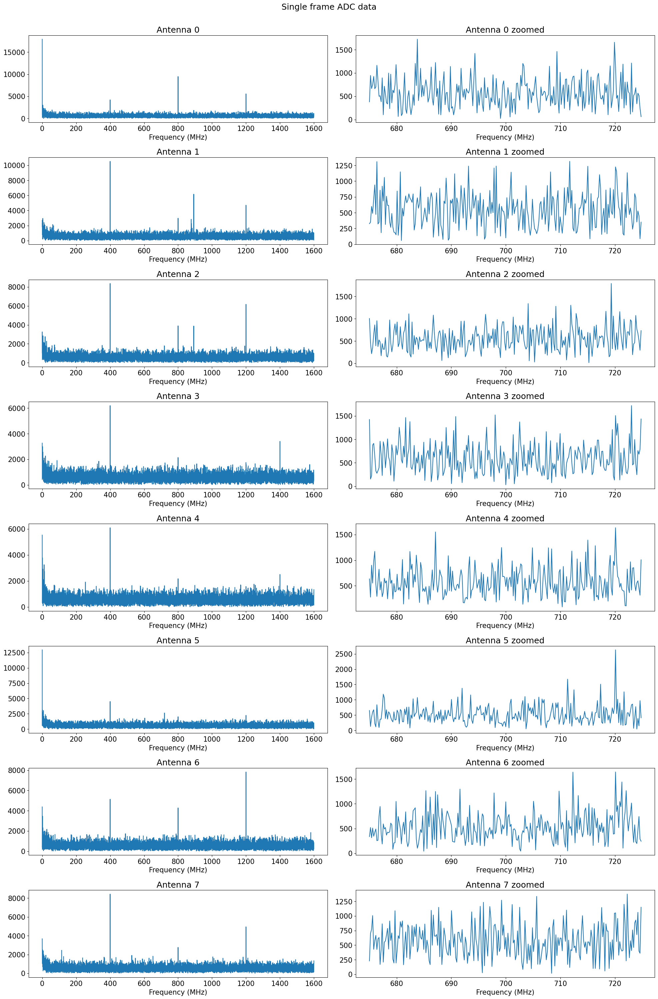

In [5]:
fig,ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('Single frame ADC data', y=1)

def find_nearest(array,value):
    idx = np.searchsorted(array, value, side="left")
    if idx > 0 and (idx == len(array) or math.fabs(value - array[idx-1]) < math.fabs(value - array[idx])):
        return idx-1
    else:
        return idx
    
lowfreq = find_nearest(ccc.f,675)
highfreq = find_nearest(ccc.f,725)
    
for i in range(8):
    ax[i,0].plot(ccc.f,np.abs(np.fft.rfft(dadc[i])[0][0:8192]))
    ax[i,1].plot(ccc.f[lowfreq:highfreq],np.abs(np.fft.rfft(dadc[i])[0][lowfreq:highfreq]))
    ax[i,1].set_xlabel('Frequency (MHz)')
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,0].set_title('Antenna '+ str(i))
    ax[i,1].set_title('Antenna '+ str(i) + ' zoomed')
    
plt.tight_layout()

In [6]:
ranges = np.zeros((8,1000))
means = []
for i in range(8):
    for n in range(ncap*2):
        ranges[i,n] = 10*np.log10((np.std(dadc[i][n])*(1/2**14))**2/100/1e-3)
    means.append(np.mean(ranges[i,:]))

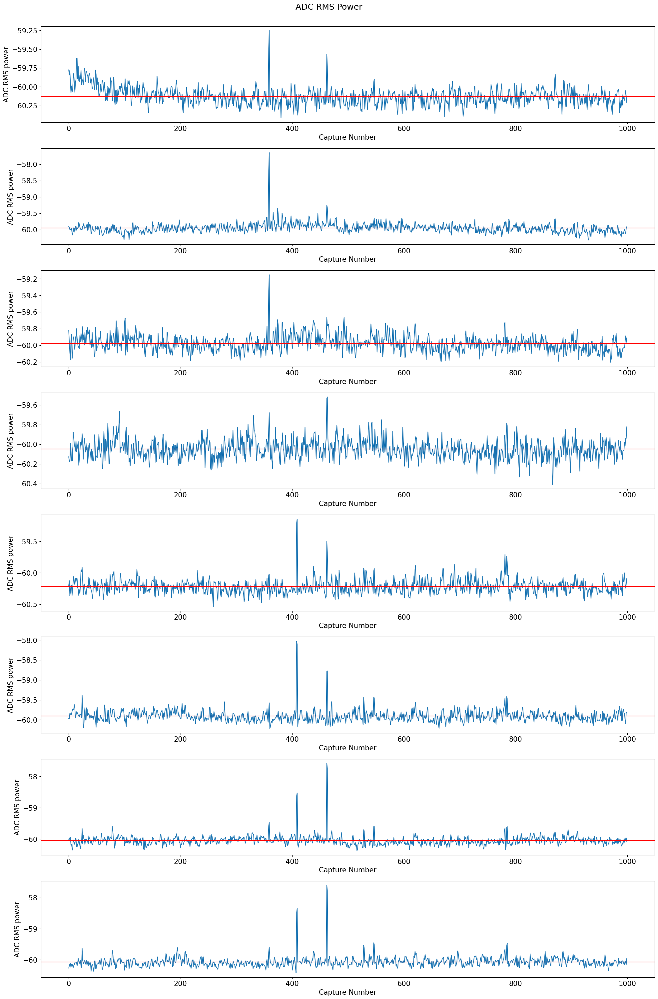

In [7]:
fig, ax = plt.subplots(8, figsize=(20,30))
plt.suptitle('ADC RMS Power', y=1)
for i in range(8):
    ax[i].plot(ranges[i])
    ax[i].set_xlabel('Capture Number')
    ax[i].set_ylabel('ADC RMS power')
    ax[i].axhline(means[i],c='r')
plt.tight_layout()

In [8]:
adcfft = np.fft.fft(dadc[:][:][0:16384],axis=2)

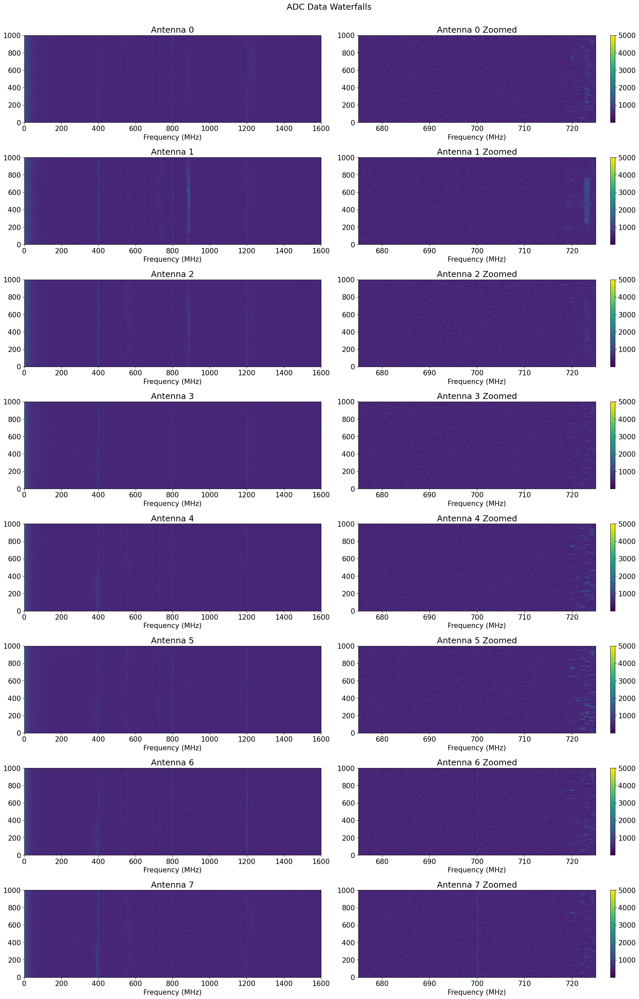

In [9]:
fig, ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('ADC Data Waterfalls', y=1)
for i in range(8):
    ax[i,0].set_title('Antenna '+ str(i))
    ax[i,1].set_title('Antenna '+ str(i)+ ' Zoomed')
    im0 = ax[i,0].imshow(np.abs(adcfft[i,:,0:8192]), vmax=5000, extent=[0,1600,0,ncap*2], aspect='auto')
    im1 = ax[i,1].imshow(np.abs(adcfft[i,:,lowfreq:highfreq]), extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap*2], vmax=5000, aspect='auto')
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    plt.colorbar(im1,ax=ax[i,1])
    
plt.tight_layout()

# Set the FFT shift to the minimum shift without overflows

Set up the FFT for single capture mode

In [10]:
n_fft_integrations = 50 # 30
n_fft_captures = 1
s_per_frame = 2**14*(1/(ccc.fs*1e6))
fft_integration_period = 2*n_fft_captures*s_per_frame # we capture two contiguous frames at a time, so we recover twice as many frames as captures
print('FFT integration period is: ', fft_integration_period)

FFT integration period is:  1.024e-05


In [11]:
fft_shift_schedules = [0b00000000000000, 0b00000000000001,0b00000000000011,0b00000000000111,0b0000000001111,0b00000000011111,
                       0b00000000111111, 0b00000001111111, 0b00000111111111,0b00001111111111, 0b00011111111111,
                      0b0011111111111, 0b01111111111111, 0b11111111111111]

In [12]:
fftOverflows = np.zeros(15)
adcOverflows = np.zeros(15)

In [13]:
for j in range(len(fft_shift_schedules)):
    for n in range(ccc.NPOLS):
        # Configure each FFT
        fft = ccc.i.chan[n].FFT
        fft.FFT_SHIFT = fft_shift_schedules[j]
        print(fft.status())
        
    psd_fft = np.zeros((n_fft_integrations, ccc.NPOLS, len(ccc.f)))
    kert_fft = np.zeros((n_fft_integrations, ccc.NPOLS, len(ccc.f)))
    fft_cap_adc_ovflws = np.zeros((n_fft_integrations, ccc.NPOLS))
    # fft_cap_adc_rms_power_dBm = np.zeros((n_adc_integrations, ccc.NPOLS))
    fft_cap_fft_ovflws = np.zeros((n_fft_integrations, ccc.NPOLS))

    for n in range(n_fft_integrations):
        print(f'{n}/{n_fft_integrations}')
    
    
        # Pulse the overflows resets
        for m in range(ccc.NPOLS):

            # Reset ADC stats capture (which is actually in the Scaler module)
            ccc.i.chan[m].SCALER.STATS_FRAME_COUNT = n_fft_captures
            ccc.i.chan[m].SCALER.STATS_CAPTURE = 0 # capture new stats
            # print(m, ccc.i.chan[m].SCALER.STATS_CAPTURE)
            ccc.i.chan[m].SCALER.STATS_CAPTURE = 1
            # print(m, ccc.i.chan[m].SCALER.STATS_CAPTURE)

            # Reset FFT overflow counter
            ccc.i.chan[m].FFT.OVERFLOW_RESET = 1 
            ccc.i.chan[m].FFT.OVERFLOW_RESET = 0

        # Capture data
        d_fft = ccc.read_fft_frames(ncap = n_fft_captures)
        psd_fft[n] = np.mean(np.abs(d_fft)**2, axis = 1)
        kert_fft[n] = np.mean(np.abs(d_fft)**4, axis = 1)

        # Measure ADC overflows
        for m in range(ccc.NPOLS):
            print('---')
            # print(m, ccc.i.chan[m].SCALER.STATS_CAPTURE)
            # print(ccc.i.chan[m].SCALER.STATS_READY)
            ctr = 0
            while True:
                if ccc.i.chan[m].SCALER.STATS_READY == 1:
                    print(f'stats ready after {ctr} cycles')
                    fft_cap_adc_ovflws[n, m] = ccc.i.chan[m].SCALER.STATS_ADC_OVERFLOWS
                    break
                else:
                    ctr += 1
                
        # Measure FFT overflows
        fft_cap_fft_ovflws[n] = [ccc.i.chan[m].FFT.OVERFLOW_COUNT for m in range(ccc.NPOLS)]
        
        fftOverflows[j] = np.sum(fft_cap_fft_ovflws)
        adcOverflows[j] = np.sum(fft_cap_adc_ovflws)

-------------- CHAN[0].FFT STATUS --------------
 FFT Bypass: True
 FFT SHIFT schedule: 0x0
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 198
None
-------------- CHAN[1].FFT STATUS --------------
 FFT Bypass: True
 FFT SHIFT schedule: 0x0
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 10
None
-------------- CHAN[2].FFT STATUS --------------
 FFT Bypass: True
 FFT SHIFT schedule: 0x0
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 3
None
-------------- CHAN[3].FFT STATUS --------------
 FFT Bypass: True
 FFT SHIFT schedule: 0x0
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 255
None
-------------- CHAN[4].FFT STATUS --------------
 FFT Bypass: True
 FFT SHIFT schedule: 0x0
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 255
None
-------------

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
12/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
26/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
40/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
1/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready a

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
15/50
Flushed 175 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
16/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
29/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
30/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
43/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
44/50
Flushed 157 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
5/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets


Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
19/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
33/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
47/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
8/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
9/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 fr

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
22/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
23/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
36/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
37/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3:

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
-------------- CHAN[0].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0xF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[1].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0xF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[2].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0xF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[3].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0xF
 CASPER block pipeling delay: Measured=12533, set point=12533:  cloc

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
12/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
13/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
26/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
27/50
Flushed 169 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 

Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
40/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready 

Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
2/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready a

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
16/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
17/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Flushed 182 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
31/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
45/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

---
stats ready after 0 cycles
---
stats ready after 0 cycles
6/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
7/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
20/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
21/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
34/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
35/50
Flushed 184 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
48/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
49/50
Flushed 188 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
10/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
24/50
Flushed 189 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
38/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
2/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets


Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
16/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
30/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
44/50
Flushed 178 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
6/50
Flushed 190 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets


Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
20/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
34/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
48/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
10/50
Flushed 170 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
24/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
25/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
38/50
Flushed 188 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
39/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
2/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready a

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
16/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
17/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
31/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
45/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
46/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
7/50
Flushed 151 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready a

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
21/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
22/50
Flushed 140 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
36/50
Flushed 127 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

 FFT Bypass: False
 FFT SHIFT schedule: 0x3FFF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[4].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x3FFF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[5].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x3FFF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[6].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x3FFF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
-------------- CHAN[7].FFT STATUS --------------
 FFT Bypass: False
 FFT SHIFT schedule: 0x3FFF
 CASPER block pipeling delay: Measured=12533, set point=12533:  clocks
 Number of FFT overflows: 0
None
0/50
Flushed 191 packets while emptying UDP buffe

Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
13/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
27/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
28/50
Flushed 184 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
C

---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
41/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 1 captures
Chan 0: -56.0 missing packets
Chan 1: -56.0 missing packets
Chan 2: -56.0 missing packets
Chan 3: -56.0 missing packets
Chan 4: -56.0 missing packets
Chan 5: -56.0 missing packets
Chan 6: -56.0 missing packets
Chan 7: -56.0 missing packets
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
---
stats ready after 0 cycles
42/50
Flushed 191 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh tim

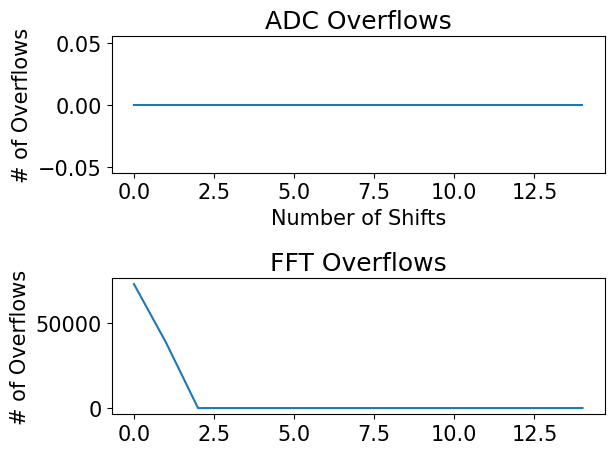

In [14]:
fig, ax = plt.subplots(2)
ax[0].plot(adcOverflows)
ax[1].plot(fftOverflows)
ax[0].set_title('ADC Overflows')
ax[1].set_title('FFT Overflows')
ax[0].set_xlabel('Number of Shifts')
ax[0].set_xlabel('Number of Shifts')
ax[0].set_ylabel('# of Overflows')
ax[1].set_ylabel('# of Overflows')
plt.tight_layout()

Set the fft shift to the minimum shift schedule with no overflows

In [15]:
for n in range(ccc.NPOLS):
    fft = ccc.i.chan[n].FFT
    fft.FFT_SHIFT = fft_shift_schedules[9]

## Check FFT data

In [16]:
ncap=500
dfft = ccc.read_fft_frames(ncap=ncap)
avg = np.mean(np.abs(dfft),axis=1)

Flushed 564 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 500 captures
Chan 0: -28000.0 missing packets
Chan 1: -28000.0 missing packets
Chan 2: -28000.0 missing packets
Chan 3: -28000.0 missing packets
Chan 4: -28000.0 missing packets
Chan 5: -28000.0 missing packets
Chan 6: -28000.0 missing packets
Chan 7: -28000.0 missing packets
Timestamp differences: {3906}


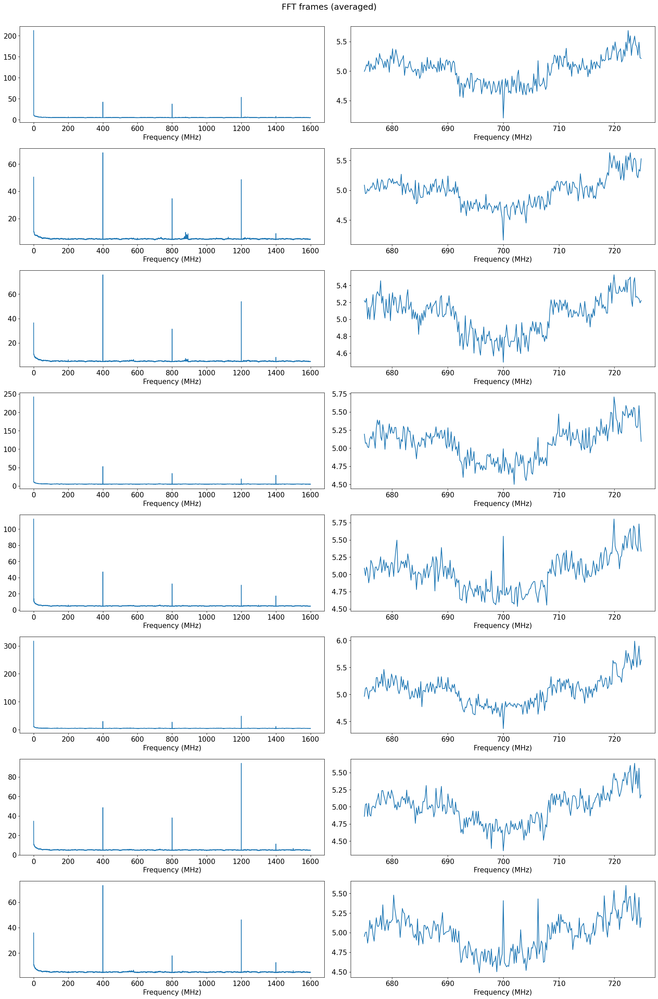

In [17]:
fig, ax = plt.subplots(8,2, figsize = (20,30))
fig.suptitle('FFT frames (averaged)', y=1)

for i in range(8):
    ax[i,0].plot(ccc.f,np.abs(avg[i,:]))
    ax[i,1].plot(ccc.f[lowfreq:highfreq],np.abs(avg[i,:][lowfreq:highfreq]))
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    
plt.tight_layout()

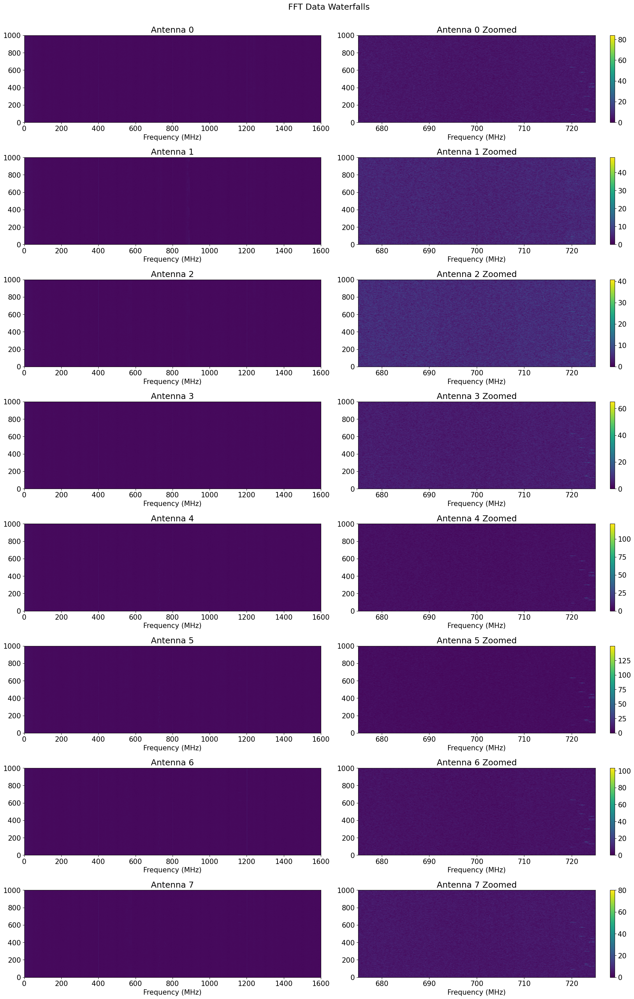

In [19]:
fig, ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('FFT Data Waterfalls', y=1)
for i in range(8):
    ax[i,0].set_title('Antenna '+ str(i))
    ax[i,1].set_title('Antenna '+ str(i)+ ' Zoomed')
    im0 = ax[i,0].imshow(np.abs(dfft[i,:]), vmax=200, extent=[0,1600,0,ncap*2], aspect='auto')
    im1 = ax[i,1].imshow(np.abs(dfft[i,:,lowfreq:highfreq]), extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap*2], aspect='auto')
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    plt.colorbar(im1,ax=ax[i,1])
    
plt.tight_layout()

### Try FFT Beamforming

In [20]:
tonefreq = find_nearest(ccc.f,703)

In [30]:
singchan = dfft[:,:,tonefreq]

plot each channel as a function of time

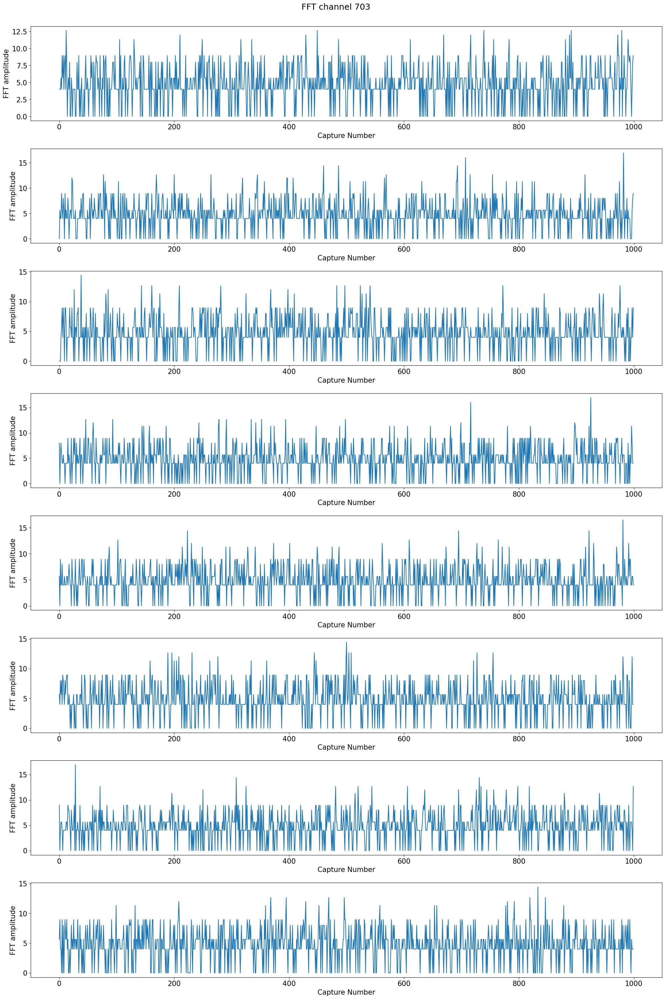

In [33]:
fig, ax = plt.subplots(8, figsize=(20,30))
plt.suptitle('FFT channel 703', y=1)
for i in range(8):
    ax[i].plot(np.abs(singchan[i]))
    ax[i].set_xlabel('Capture Number')
    ax[i].set_ylabel('FFT amplitude')
plt.tight_layout()

beamform

In [60]:
bfframes = np.zeros((8,ncap*2), dtype=complex)
for i in range(ncap*2):
    fftbf = np.fft.fftshift(np.fft.fft(singchan[:,i]))
    bfframes[:,i] = fftbf
ns = np.array([-4,-3,-2,-1,0,1,2,3,])

Text(0.5, 0, 'Beam number')

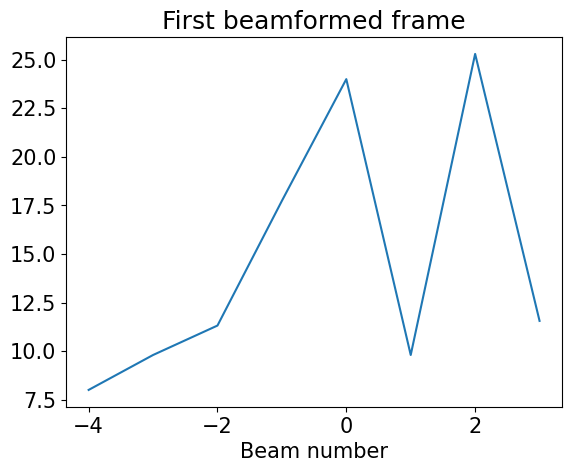

In [61]:
plt.title('First beamformed frame')
plt.plot(ns, np.abs(bfframes[:,0]))
plt.xlabel('Beam number')

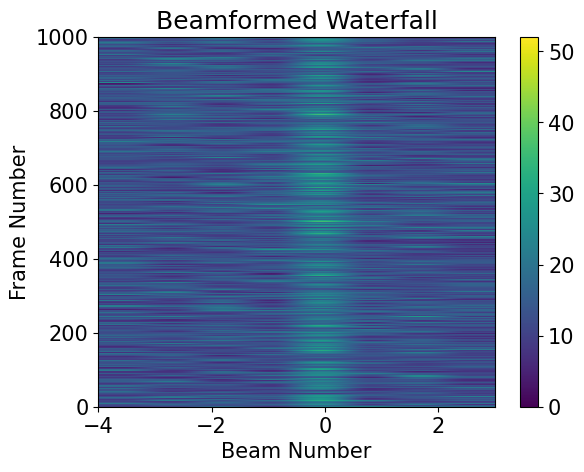

In [64]:
plt.imshow(np.abs(bfframes.T), extent=[-4,3,0,ncap*2], aspect='auto')
plt.title('Beamformed Waterfall')
plt.xlabel('Beam Number')
plt.ylabel('Frame Number')
plt.colorbar()

Trace out each beam 

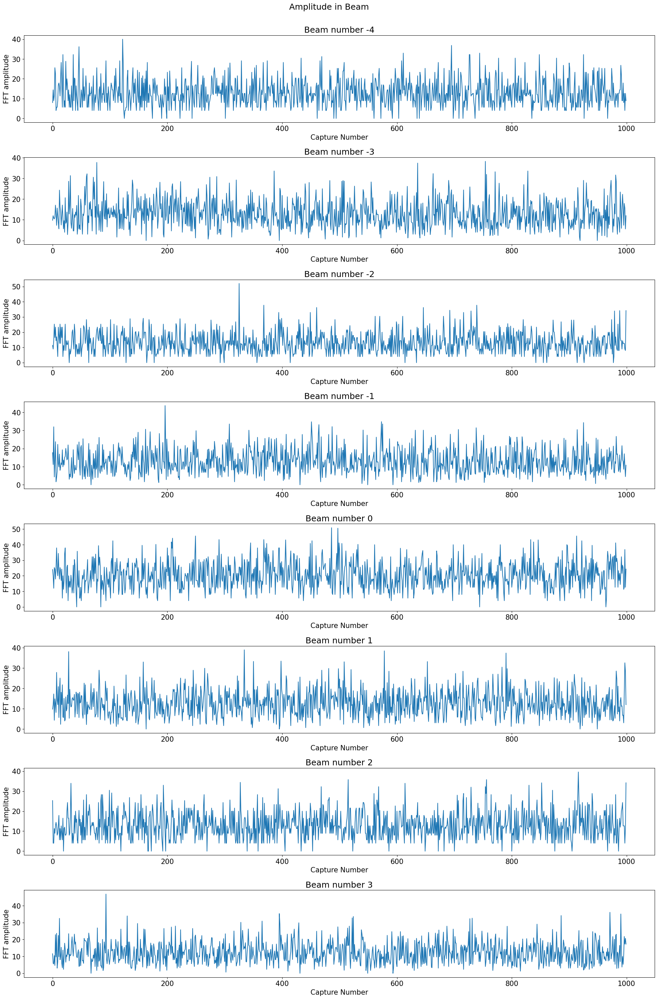

In [65]:
fig, ax = plt.subplots(8, figsize=(20,30))
plt.suptitle('Amplitude in Beam', y=1)
for i in range(8):
    ax[i].plot(np.abs(bfframes[i,:]))
    ax[i].set_xlabel('Capture Number')
    ax[i].set_ylabel('FFT amplitude')
    ax[i].set_title('Beam number ' + str(ns[i]))
plt.tight_layout()

## Check Scalar Data and Compute Gains

Automatically compute gains to get an estimate of the appropriate log gain

In [21]:
fft_data, fft_rms, gain, lin, log, scaler_data = ccc.compute_gains(gain_type = 'raw',
                                                                   number_of_fft_averages = 250, # 250 is plenty! Recall that it's really 2*250 frames per input in mode 0
                                                                   rms_accuracy_tol = None, # Ignore
                                                                   save_gains = False
                                                                   )

Gain computation trial 0
Flushed 15820 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 125 captures
Chan 0: -7000.0 missing packets
Chan 1: -7000.0 missing packets
Chan 2: -7000.0 missing packets
Chan 3: -7000.0 missing packets
Chan 4: -7000.0 missing packets
Chan 5: -7000.0 missing packets
Chan 6: -7000.0 missing packets
Chan 7: -7000.0 missing packets
Timestamp differences: {3906}
FFT Overflows: [0. 0. 0. 0. 0. 0. 0. 0.]
log [18. 18. 18. 18. 18. 18. 18. 18.]
Setting gains to raw
Skipping Scaler tolerance check.


look at scalar frames with agc

In [23]:
dsclr = ccc.read_scaler_frames(ncap = 500)
avg = np.mean(np.abs(dsclr),axis=1)

Flushed 1599 packets while emptying UDP buffers
Skipped 65 packets while waiting for a fresh timestamp
mode=0, 8 channel(s), 2 frames per channel, 500 captures
Chan 0: -28000.0 missing packets
Chan 1: -28000.0 missing packets
Chan 2: -28000.0 missing packets
Chan 3: -28000.0 missing packets
Chan 4: -28000.0 missing packets
Chan 5: -28000.0 missing packets
Chan 6: -28000.0 missing packets
Chan 7: -28000.0 missing packets
Timestamp differences: {1953}


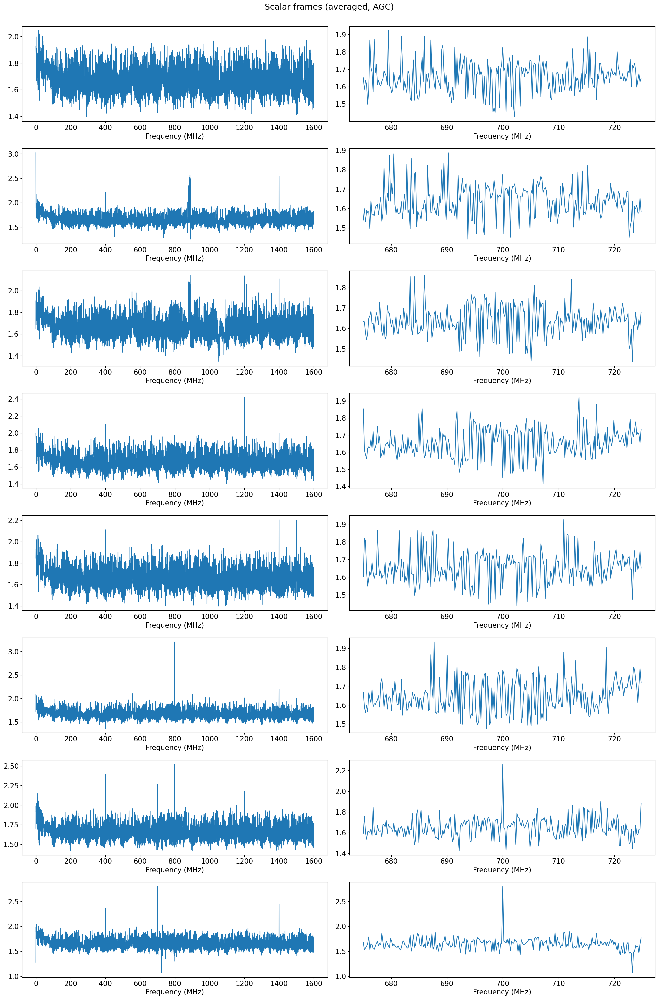

In [24]:
fig, ax = plt.subplots(8,2, figsize = (20,30))
fig.suptitle('Scalar frames (averaged, AGC)', y=1)

for i in range(8):
    ax[i,0].plot(ccc.f,np.abs(avg[i,:]))
    ax[i,1].plot(ccc.f[lowfreq:highfreq],np.abs(avg[i,:][lowfreq:highfreq]))
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    
plt.tight_layout()

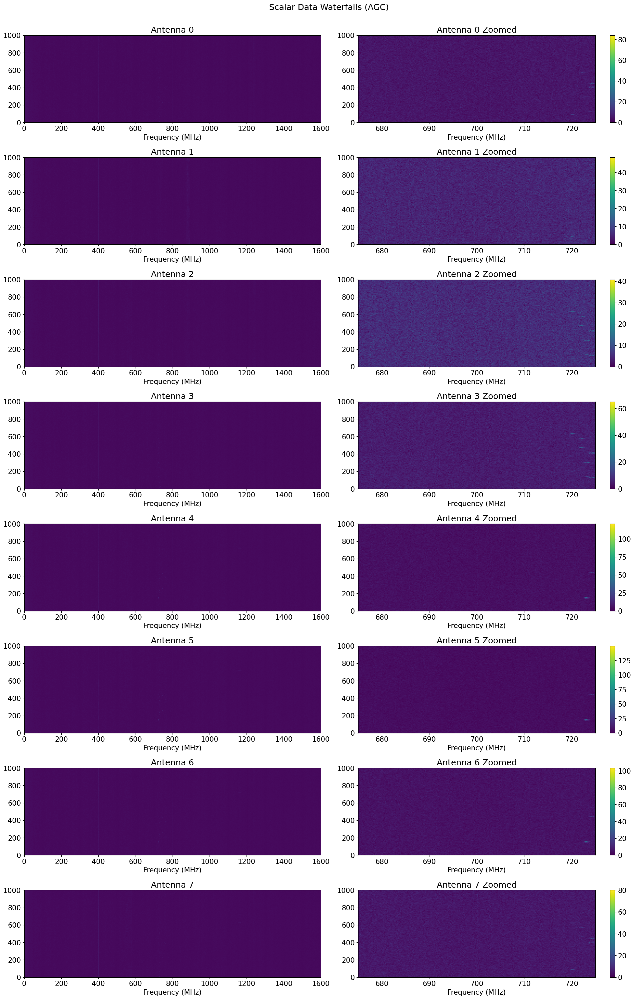

In [25]:
fig, ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('Scalar Data Waterfalls (AGC)', y=1)
for i in range(8):
    ax[i,0].set_title('Antenna '+ str(i))
    ax[i,1].set_title('Antenna '+ str(i)+ ' Zoomed')
    im0 = ax[i,0].imshow(np.abs(dfft[i,:]), vmax=200, extent=[0,1600,0,ncap*2], aspect='auto')
    im1 = ax[i,1].imshow(np.abs(dfft[i,:,lowfreq:highfreq]), extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap*2], aspect='auto')
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    plt.colorbar(im1,ax=ax[i,1])
    
plt.tight_layout()

manually recompute gains if needed

In [26]:
lin=30*np.ones((8,8192))
log = [18]*8
log=[int(n) for n in log]
ccc.set_gains(lin,log)

In [ ]:
dsclr = ccc.read_scaler_frames(ncap = 500)
avg = np.mean(np.abs(dsclr),axis=1)

In [ ]:
fig, ax = plt.subplots(8,2, figsize = (20,30))
fig.suptitle('Scalar frames (averaged, MGC)', y=1)

for i in range(8):
    ax[i,0].plot(ccc.f,np.abs(avg[i,:]))
    ax[i,1].plot(ccc.f[lowfreq:highfreq],np.abs(avg[i,:][lowfreq:highfreq]))
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    
plt.tight_layout()

In [ ]:
fig, ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('Scalar Data Waterfalls (MGC)', y=1)
for i in range(8):
    ax[i,0].set_title('Antenna '+ str(i))
    ax[i,1].set_title('Antenna '+ str(i)+ ' Zoomed')
    im0 = ax[i,0].imshow(np.abs(dsclr[i,:]), extent=[0,1600,0,ncap*2], aspect='auto')
    im1 = ax[i,1].imshow(np.abs(dsclr[i,:,lowfreq:highfreq]), extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap*2], aspect='auto')
    ax[i,0].set_xlabel('Frequency (MHz)')
    ax[i,1].set_xlabel('Frequency (MHz)')
    plt.colorbar(im1,ax=ax[i,1])
    
plt.tight_layout()

## Get Correlator Frames

In [ ]:
# Generate product array
prod_idx = np.triu_indices(8)
prod = np.zeros((len(prod_idx[0]), 2))
for n in range(prod.shape[0]):
    prod[n] = (prod_idx[0][n], prod_idx[1][n])
prod = prod.astype(np.int16)

# Configure correlator
ccc.ucap.OUTPUT_SOURCE_SEL = 1 # 0: channelizer data, 1: correlator data
ccc.corr = ccc.i.CORR # correlator object
ccc.corr_receiver = ccc.i.get_corr_receiver() # correlator receiver object
ccc.corr.AUTOCORR_ONLY = 0 # 0: all products, 1: autocorrelation only
ccc.corr.NO_ACCUM = 0 # 0: do accumulate, 1: don't accumulate
ccc.NCORR_PROD = int(ccc.NPOLS*(ccc.NPOLS + 1) // 2)
ccc.corr.INTEGRATION_PERIOD = 16384 - 1 # Min: 8192 - 1 (I think), default: 16384 - 1, max: 65536 - 1. Default typically sufficient to ensure no overflows.
ccc.corr_is_configured = True # Set the correlator configure check

In [ ]:
# Set the desired integration time and number of software frames to integrate.
s_per_frame = 2**14*(1/(ccc.fs*1e6)) # samples/frame * seconds/sample. Make sure sampling frequency is in Hz.
set_integration_time = .1 # s
n_firmware_frames = ccc.corr.INTEGRATION_PERIOD + 1 # The number frames to integrate in the FPGA before sending to python
n_software_frames = int(set_integration_time / s_per_frame / n_firmware_frames) # The number of frames to integrate in python
actual_integration_time = n_firmware_frames * n_software_frames * s_per_frame # The true integration time
print(f'Target integration time: {set_integration_time} s')
print(f'Actual integration time: {actual_integration_time} s')

n_integrations = 100
ncap=n_integrations

t, vis, counts, sat = ccc.read_corr_frames(data_source = 'adc', # Could be the ADC or the firmware function generator
                                            soft_integ_period = n_software_frames, # Specify the number of software frames
                                            number_of_results = n_integrations, # The number of integrations to return
                                            filename = None, # Ignore
                                            flush = True, # Flushes the UDP buffer. Should be true whenever you're capturing quick bursts.
                                            align = False,
                                            data_timeout = 0.1,
                                            flush_timeout = 0.01,
                                            return_format = 'raw',
                                            verbose = 0, # 0 is most noisy, set to 1 for fewer printours.
                                            corr_is_configured = ccc.corr_is_configured)

In [ ]:
prod_idx = np.triu_indices(8)
prod = np.zeros((len(prod_idx[0]), 2))
for n in range(prod.shape[0]):
    prod[n] = (prod_idx[0][n], prod_idx[1][n])
prod = prod.astype(np.int16)

look at just the autocorrelation products, first frame

In [ ]:
fig, ax = plt.subplots(8,2, figsize = (20,30))
fig.suptitle('Correlator frames (single)', y=1)

j=0
for i in range(36):
    if i in (0, 8, 15, 21, 26, 30, 33, 35):
        ax[j,0].plot(ccc.f,np.abs(vis[0,:,i]))
        ax[j,1].plot(ccc.f[lowfreq:highfreq],np.abs(vis[0,:,i][lowfreq:highfreq]))
        ax[j,0].set_xlabel('Frequency (MHz)')
        ax[j,1].set_xlabel('Frequency (MHz)')
        j+=1
plt.tight_layout()
plt.xlabel('Frequency (MHz)')

In [ ]:
fig, ax = plt.subplots(8,2, figsize=(20,30))
fig.suptitle('Correlator Data Waterfalls', y=1)

j=0
for i in range(36):
    if i in (0, 8, 15, 21, 26, 30, 33, 35):
        ax[j,0].set_title('Antenna '+ str(i))
        ax[j,1].set_title('Antenna '+ str(i)+ ' Zoomed')
        im0 = ax[j,0].imshow(np.abs(vis[:,:,i]), vmax=600, extent=[0,1600,0,ncap*2], aspect='auto')
        im1 = ax[j,1].imshow(np.abs(vis[:,lowfreq:highfreq,i]), extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap], aspect='auto')
        ax[j,0].set_xlabel('Frequency (MHz)')
        ax[j,1].set_xlabel('Frequency (MHz)')
        plt.colorbar(im1,ax=ax[j,1])
        plt.colorbar(im0,ax=ax[j,0])
        j+=1
    
plt.tight_layout()

look at all products

In [ ]:
fig, axs = plt.subplots(8,8,figsize=(18,30),sharey=True)
fig.suptitle('Correlator Data (Linear)', y=1)
for i in range(36):
    axs[prod[i][0],prod[i][1]].plot(ccc.f,np.abs(vis[0,:,i]))
    axs[prod[i][0],prod[i][1]].set_title("Corr{antcorr}".format(antcorr = prod[i]))
    axs[prod[i][0],prod[i][1]].set_xlabel('Frequency (MHz)')
plt.tight_layout()

zoom in on tone

In [ ]:
fig, axs = plt.subplots(8,8,figsize=(18,30),sharey=True)
fig.suptitle('Correlator Data (Zoomed)', y=1)
for i in range(36):
    axs[prod[i][0],prod[i][1]].plot(ccc.f[lowfreq:highfreq],np.abs(vis[0,:,i][lowfreq:highfreq]))
    axs[prod[i][0],prod[i][1]].set_title("Corr{antcorr}".format(antcorr = prod[i]))
    axs[prod[i][0],prod[i][1]].set_xlabel('Frequency (MHz)')
plt.tight_layout()

In [ ]:
fig, axs = plt.subplots(8,8,figsize=(18,30),sharey=True)

for i in range(36):
    
    im0 = axs[prod[i][0],prod[i][1]].imshow(np.abs(vis[:,:,i]), vmax=660, extent=[0,1600,0,ncap], aspect='auto')
    axs[prod[i][0],prod[i][1]].set_title("Corr{antcorr}".format(antcorr = prod[i]))
    axs[prod[i][0],prod[i][1]].set_xlabel('Frequency (MHz)')
fig.suptitle('Correlator Waterfalls)', y=1)
plt.colorbar(im0,ax=axs[0,7])     
plt.tight_layout()

In [ ]:
fig, axs = plt.subplots(8,8,figsize=(18,30),sharey=True)

for i in range(36):
    
    im0 = axs[prod[i][0],prod[i][1]].imshow(np.abs(vis[:,lowfreq:highfreq,i]), vmax=660, extent=[ccc.f[lowfreq],ccc.f[highfreq],0,ncap], aspect='auto')
    axs[prod[i][0],prod[i][1]].set_title("Corr{antcorr}".format(antcorr = prod[i]))
    axs[prod[i][0],prod[i][1]].set_xlabel('Frequency (MHz)')
fig.suptitle('Correlator Waterfalls (zoomed)', y=1)
plt.colorbar(im0,ax=axs[0,7])     
plt.tight_layout()

### Use Observe Func

save gains computed by hand

In [ ]:
ccc.digital_gains_path = '/home/lmberkhout/src/ref_gains/digital_gains'
ccc.gain_file_path = '/home/lmberkhout/src/ref_gains/digital_gains'
ccc.gain_file_name = '/home/lmberkhout/src/ref_gains/digital_gains'
ccc.save_gains(lin, log, 'raw')

In [ ]:
ccc.observe(data_path = '/home/lmberkhout/src/ref_gains',
    digital_gains_path = '/home/lmberkhout/src/ref_gains/digital_gains',
    n_vis_per_file=256,
    integration_time=.1,
    gain_target=2.121320343559643,
    number_of_fft_averages=1000,
    gain_type='raw',
    capture_adc_bursts=False,
    n_adc_bursts=0,
    capture_fft_bursts=False,
    n_fft_bursts=0
)

## Read back in data

In [ ]:
from load_acq_rfsoc import load_data
import h5py

In [ ]:
acq = '20241126T161018Z_D3A_rfsoc'
vis_all, f, prod, t_all, counts_all, glin, glog, sat_all, adc_overflows_all, fft_overflows_all, scaler_overflows_all, corr_overrun_all, frame_count_all = load_data(acq, 
              '/home/lmberkhout/src/ref_gains', 
              '/home/lmberkhout/src/ref_gains/digital_gains',
              prod_sel = None,
              freq_sel = None,
              file_sel = None,
              time_bounds = None,
              inputs = None,
              trim_non_valid_data = True,
              apply_counts = True,
              apply_gains = False,
              )